In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from templates import *
from templates_cls import *
from experiment_classifier import ClsModel

In [3]:
device = 'cuda:0'
conf = ffhq256_autoenc()
# print(conf.name)
model = LitModel(conf)
state = torch.load(f'checkpoints/{conf.name}/last.ckpt', map_location='cpu')
model.load_state_dict(state['state_dict'], strict=False)
model.ema_model.eval()
model.ema_model.to(device);

Global seed set to 0


Model params: 160.69 M


In [4]:
cls_conf = ffhq256_autoenc_cls()
cls_model = ClsModel(cls_conf)
state = torch.load(f'checkpoints/{cls_conf.name}/last.ckpt',
                    map_location='cpu')
print('latent step:', state['global_step'])
cls_model.load_state_dict(state['state_dict'], strict=False)
cls_model.to(device);

Global seed set to 0


loading pretrain ... 130M
step: 1563562
loading latent stats ...
latent step: 9375


## 選択

In [5]:
is_avg = False  # avg_face用
is_crop = True  # crop用
if is_avg:
    img_from_base_dir = 'imgs_test/imgs_synthetic_avg/avg_face3/'
elif is_crop:
    img_from_base_dir = 'imgs_test/imgs_crop/'
else:
    img_from_base_dir = 'imgs_test/imgs_synthetic/'
    
from_dirs = []
for i,file in enumerate(os.listdir(img_from_base_dir)):
    print(f'{i:2}: {file}')
    from_dirs.append(file)

 0: ookawa_default-ookawa_angry2
 1: yotaka_default-yotaka_angry2
 2: yotaka_default-yotaka_smile


In [6]:
ind_from = 2
img_from_dir = img_from_base_dir + f"/{from_dirs[ind_from]}"  # 選択
name_from_dir = from_dirs[ind_from]

for i,file in enumerate(os.listdir(img_from_dir)):
    print(f'{i:2}: {file}')

 0: crop_eye_from.png
 1: crop_eye_mouth_from.png
 2: crop_eye_mouth_to.png
 3: crop_eye_to.png
 4: crop_from.png
 5: crop_to.png


In [7]:
img_to_dir = 'imgs_align'
for i,file in enumerate(os.listdir(img_to_dir)):
    print(f'{i:2}: {file}')

 0: azuki_default.png
 1: ceo_default.png
 2: check1.png
 3: check2.png
 4: danda_default.png
 5: detective.png
 6: detective_02.png
 7: glasses.png
 8: idPhoto.png
 9: mio_happy.png
10: mio_shock.png
11: mio_silence.png
12: mio_u.png
13: nanko_default.png
14: ookawa_angry.png
15: ookawa_angry2.png
16: ookawa_default.png
17: ookawa_high.png
18: ookawa_regret.png
19: ookawa_smile.png
20: ookawa_surprised.png
21: pharmacist.png
22: saki.png
23: saki_glasses.png
24: sandy.png
25: takebe_default.png
26: test01.png
27: test01_02.png
28: test01_03.png
29: test01_04.png
30: test02.png
31: test02_02.png
32: test02_03.png
33: woman_default.png
34: yotaka_angry.png
35: yotaka_angry2.png
36: yotaka_bald.png
37: yotaka_bushy.png
38: yotaka_default.png
39: yotaka_gj.png
40: yotaka_smile.png
41: yotaka_smile2.png


In [8]:
data = ImageDataset(img_from_dir, image_size=conf.img_size, exts=['jpg', 'JPG', 'png'], do_augment=False, sort_names=True)
if is_avg:
    ind_batch_from = [12,13,14,15,6,7,4,5,2,3,10,11,0,1,8,9]
elif is_crop:
    ind_batch_from = [6,11,2,5,0,1,7,10,3,4,8,9]
else:
    ind_batch_from = [6,7,8,9,3,1,2,5,0,4]  # [ori_fm, ori_to, pose_fm_pose_to, fall, eye, eye2, mouth, eyemouth, mouthnose] いじらない
batch_from = np.array(data[ind_batch_from[0]]['img'][None])
names_batch_from = [os.path.splitext(str(data.paths[ind_batch_from[0]]))[0]]
for i in range(1, len(ind_batch_from)):
    batch_from = np.append(batch_from, data[ind_batch_from[i]]['img'][None], axis=0)
    names_batch_from.append(os.path.splitext(str(data.paths[ind_batch_from[i]]))[0])
batch_from = torch.tensor(batch_from)

data2 = ImageDataset(img_to_dir, image_size=conf.img_size, exts=['jpg', 'JPG', 'png'], do_augment=False)
ind_batch_to = [30,28,25,33,7]  # 選択
# ind_batch_to = [24]
num_to = len(ind_batch_to)
batch_to = np.array(data2[ind_batch_to[0]]['img'][None])
names_batch_to = [os.path.splitext(str(data2.paths[ind_batch_to[0]]))[0]]
for i in range(1, len(ind_batch_to)):
    batch_to = np.append(batch_to, data2[ind_batch_to[i]]['img'][None], axis=0)
    names_batch_to.append(os.path.splitext(str(data2.paths[ind_batch_to[i]]))[0])
batch_to = torch.tensor(batch_to)

IndexError: list index out of range

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 2+num_to, figsize=(5*(2+num_to), 5))
for i in range(2):
    ax[i].imshow(batch_from[i].permute([1, 2, 0]) / 2 + 0.5)
    ax[i].set_title(f"from{i+1}")

for i in range(num_to):
    ax[i+2].imshow(batch_to[i].permute([1, 2, 0]) / 2 + 0.5)
    ax[i+2].set_title(f"to{i+1} {names_batch_to[i]}")

plt.show()

In [76]:
cond_to = []
cond_to_norm = []
xT_to = []
for i in range(num_to):
    cond_to_tmp = model.encode(batch_to[i][None].to(device))
    cond_to.append(cond_to_tmp[0])
    cond_to_norm_tmp = cls_model.normalize(cond_to_tmp)
    cond_to_norm.append(cond_to_norm_tmp[0])
    xT_to_tmp = model.encode_stochastic(batch_to[i][None].to(device), cond_to_tmp, T=250)
    xT_to.append(xT_to_tmp[0])
cond_to = torch.stack(cond_to)
cond_to_norm = torch.stack(cond_to_norm)
xT_to = torch.stack(xT_to)

In [77]:
def cos(a, b):
    a = a.view(-1)
    b = b.view(-1)
    a = F.normalize(a, dim=0)
    b = F.normalize(b, dim=0)
    return (a * b).sum()

alpha = torch.tensor(np.linspace(0, 1, 11, dtype=np.float32)).to(device)

## all

In [78]:
index_pts = [0,1]
batch_from_all = torch.stack([batch_from[index_pts[0]], batch_from[index_pts[1]]]).to(device)
cond_from_all = model.encode(batch_from_all)
xT_from_all = model.encode_stochastic(batch_from_all, cond_from_all, T=250)

intp_from = cond_from_all[0][None] * (1 - alpha[:, None]) + cond_from_all[1][None] * alpha[:, None]
theta_from = torch.arccos(cos(xT_from_all[0], xT_from_all[1]))
x_shape = xT_from_all[0].shape
intp_x_from = (torch.sin((1 - alpha[:, None]) * theta_from) * xT_from_all[0].flatten(0, 2)[None] + torch.sin(alpha[:, None] * theta_from) * xT_from_all[1].flatten(0, 2)[None]) / torch.sin(theta_from)
intp_x_from = intp_x_from.view(-1, *x_shape)

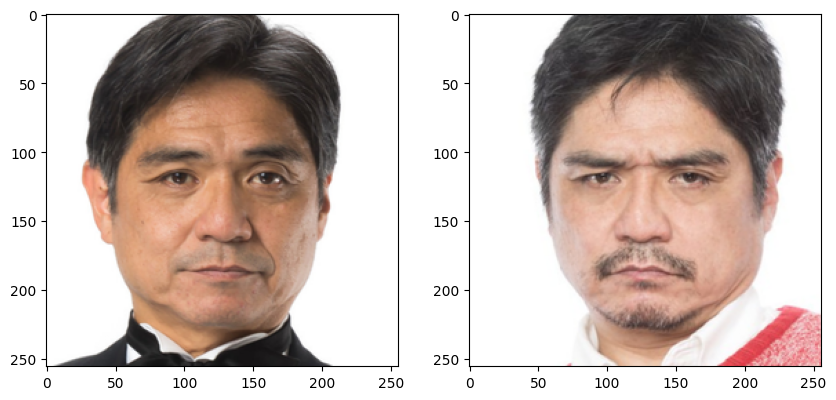

In [79]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 2, figsize=(5*2, 5))
ax[0].imshow(batch_from_all[0].permute([1, 2, 0]).cpu() / 2 + 0.5)
ax[1].imshow(batch_from_all[1].permute([1, 2, 0]).cpu() / 2 + 0.5)
plt.show()

In [80]:
cond_change_all = cls_model.normalize(cond_from_all[1][None]) - cls_model.normalize(cond_from_all[0][None])

xTs_all = torch.tensor([], device=device)
conds_all = torch.tensor([], device=device)
for i in range(num_to):
    xTs_tmp = torch.tensor([], device=device)
    conds_tmp = torch.tensor([], device=device)
    xT_change = xT_to[i] - intp_x_from[0]
    xT_to_s = torch.linalg.norm(xT_to[i])
    for j,alp in enumerate(alpha):
        xT2 = intp_x_from[j] + xT_change
        xT2_s = torch.linalg.norm(xT2)
        xT2 = xT2 / xT2_s * xT_to_s
        xTs_tmp = torch.cat([xTs_tmp, xT2[None]], dim=0)
        xT_change = xTs_tmp[j] - intp_x_from[j]
        xT_to_s = torch.linalg.norm(xTs_tmp[j])
        cond2 = cond_to_norm[i] + alp * cond_change_all
        cond2 = cls_model.denormalize(cond2)
        conds_tmp = torch.cat([conds_tmp, cond2], dim=0)
    xTs_all = torch.cat([xTs_all, xTs_tmp[None]], dim=0)
    conds_all = torch.cat([conds_all, conds_tmp[None]], dim=0)

In [81]:
preds_all = torch.tensor([], device=device)
for i in range(num_to):
    preds_tmp = torch.tensor([], device=device)
    for j in range(len(alpha)):
        pred = model.render(xTs_all[i,j][None], conds_all[i,j][None], T=20)
        preds_tmp = torch.cat([preds_tmp, pred], dim=0)
    preds_all = torch.cat([preds_all, preds_tmp[None]], dim=0)

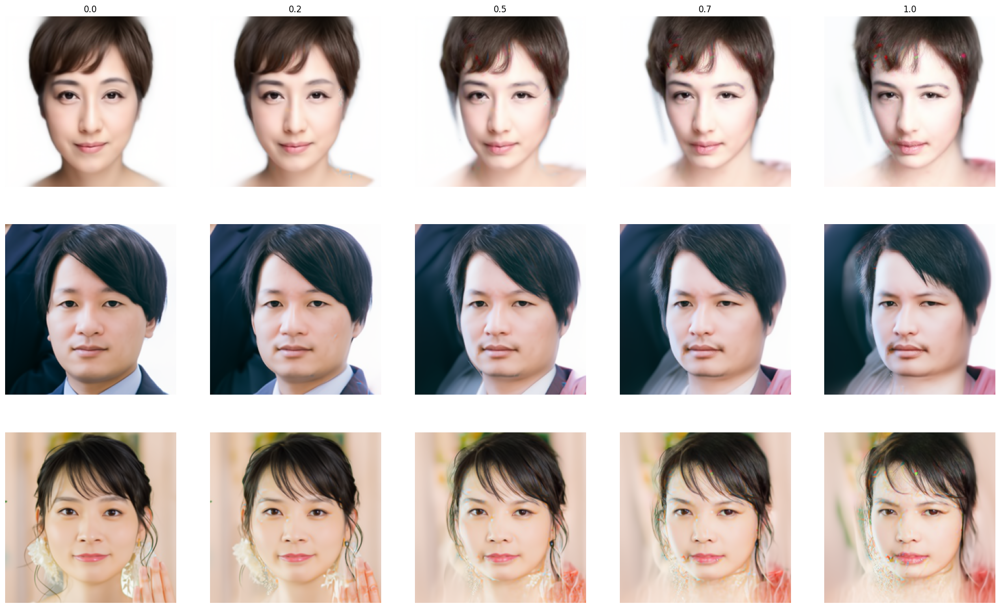

In [82]:
import matplotlib.pyplot as plt

num_show = 5
fig,ax = plt.subplots(num_to, num_show, figsize=(5*num_show, 5*num_to))
for i,pred in enumerate(preds_all):
    for j,k in enumerate(np.linspace(0,len(pred)-1,num_show,dtype=np.uint8)):
        if len(preds_all) < 2:
            ax[j].imshow(pred[k].permute(1,2,0).cpu())
            ax[j].set_title(np.array(alpha[k].cpu()))
            ax[j].axis('off')
        else:
            ax[i,j].imshow(pred[k].permute(1,2,0).cpu())
            if i == 0:
                ax[i,j].set_title(np.array(alpha[k].cpu()))
            ax[i,j].axis('off')

In [83]:
from PIL import Image

preds_all_pil = []
for pred in preds_all:
    pred_pil = []
    for p in pred:
        p_np = np.array((p*255).permute(1,2,0).cpu()).astype(np.uint8)
        pred_pil.append(Image.fromarray(p_np))
    preds_all_pil.append(pred_pil)

## pose

In [84]:
index_pts = [2,3]
batch_from_pose = torch.stack([batch_from[index_pts[0]], batch_from[index_pts[1]]]).to(device)
cond_from_pose = model.encode(batch_from_pose)
xT_from_pose = model.encode_stochastic(batch_from_pose, cond_from_pose, T=250)

intp_from = cond_from_pose[0][None] * (1 - alpha[:, None]) + cond_from_pose[1][None] * alpha[:, None]
theta_from = torch.arccos(cos(xT_from_pose[0], xT_from_pose[1]))
x_shape = xT_from_pose[0].shape
intp_x_from = (torch.sin((1 - alpha[:, None]) * theta_from) * xT_from_pose[0].flatten(0, 2)[None] + torch.sin(alpha[:, None] * theta_from) * xT_from_pose[1].flatten(0, 2)[None]) / torch.sin(theta_from)
intp_x_from = intp_x_from.view(-1, *x_shape)

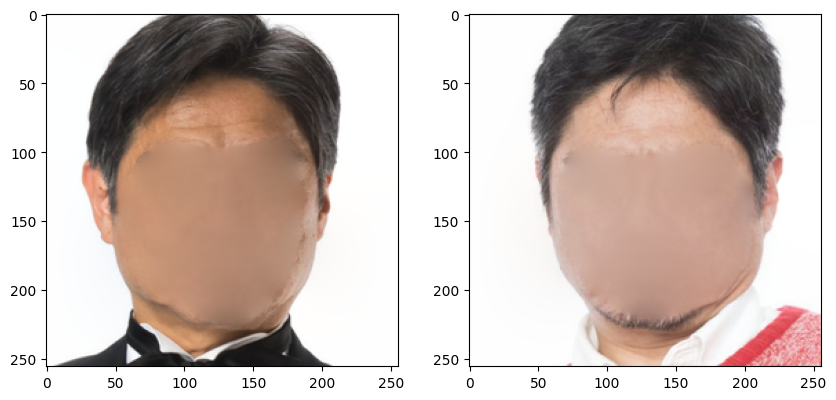

In [85]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 2, figsize=(5*2, 5))
ax[0].imshow(batch_from_pose[0].permute([1, 2, 0]).cpu() / 2 + 0.5)
ax[1].imshow(batch_from_pose[1].permute([1, 2, 0]).cpu() / 2 + 0.5)
plt.show()

In [86]:
cond_from_pose.shape

torch.Size([2, 512])

In [87]:
cond_change_pose = cls_model.normalize(cond_from_pose[1][None]) - cls_model.normalize(cond_from_pose[0][None])

xTs_pose = torch.tensor([], device=device)
conds_pose = torch.tensor([], device=device)
for i in range(num_to):
    xTs_tmp = torch.tensor([], device=device)
    conds_tmp = torch.tensor([], device=device)
    xT_change = xT_to[i] - intp_x_from[0]
    xT_to_s = torch.linalg.norm(xT_to[i])
    for j,alp in enumerate(alpha):
        xT2 = intp_x_from[j] + xT_change
        xT2_s = torch.linalg.norm(xT2)
        xT2 = xT2 / xT2_s * xT_to_s
        xTs_tmp = torch.cat([xTs_tmp, xT2[None]], dim=0)
        xT_change = xTs_tmp[j] - intp_x_from[j]
        xT_to_s = torch.linalg.norm(xTs_tmp[j])
        cond2 = cond_to_norm[i] + alp * cond_change_pose
        cond2 = cls_model.denormalize(cond2)
        conds_tmp = torch.cat([conds_tmp, cond2], dim=0)
    xTs_pose = torch.cat([xTs_pose, xTs_tmp[None]], dim=0)
    conds_pose = torch.cat([conds_pose, conds_tmp[None]], dim=0)

In [88]:
preds_pose = torch.tensor([], device=device)
for i in range(num_to):
    preds_tmp = torch.tensor([], device=device)
    for j in range(len(alpha)):
        pred = model.render(xTs_pose[i,j][None], conds_pose[i,j][None], T=20)
        preds_tmp = torch.cat([preds_tmp, pred], dim=0)
    preds_pose = torch.cat([preds_pose, preds_tmp[None]], dim=0)

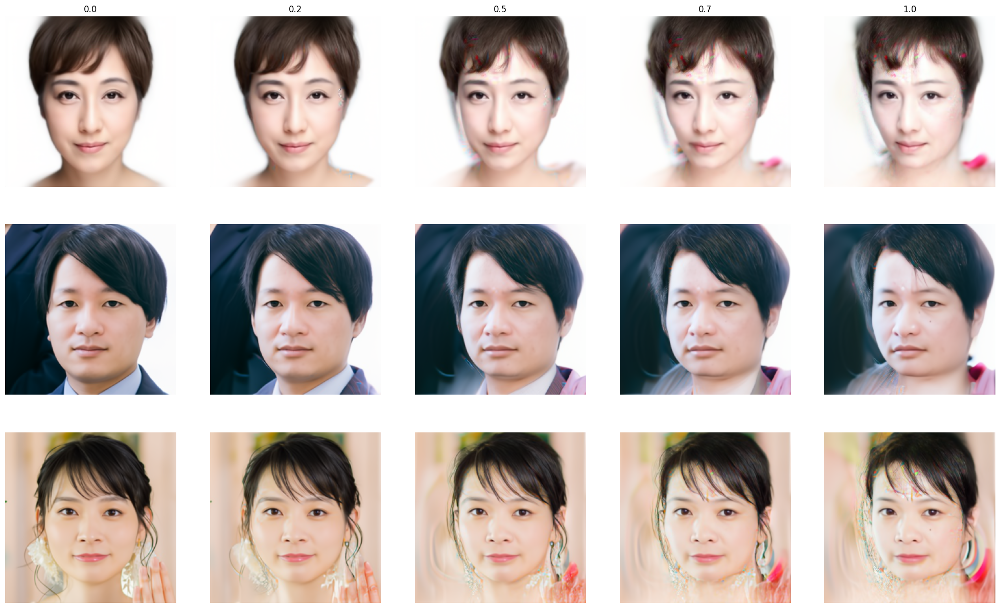

In [89]:
import matplotlib.pyplot as plt

num_show = 5
fig,ax = plt.subplots(num_to, num_show, figsize=(5*num_show, 5*num_to))
for i,pred in enumerate(preds_pose):
    for j,k in enumerate(np.linspace(0,len(pred)-1,num_show,dtype=np.uint8)):
        if len(preds_pose) < 2:
            ax[j].imshow(pred[k].permute(1,2,0).cpu())
            ax[j].set_title(np.array(alpha[k].cpu()))
            ax[j].axis('off')
        else:
            ax[i,j].imshow(pred[k].permute(1,2,0).cpu())
            if i == 0:
                ax[i,j].set_title(np.array(alpha[k].cpu()))
            ax[i,j].axis('off')

In [90]:
from PIL import Image

preds_pose_pil = []
for pred in preds_pose:
    pred_pil = []
    for p in pred:
        p_np = np.array((p*255).permute(1,2,0).cpu()).astype(np.uint8)
        pred_pil.append(Image.fromarray(p_np))
    preds_pose_pil.append(pred_pil)

## face-all

In [22]:
if is_avg:
    index_pts = [4,5]  # avg_face用
elif is_crop:
    index_pts = [0,1]  # crop用
else:
    index_pts = [0,4]
batch_from_faceall = torch.stack([batch_from[index_pts[0]], batch_from[index_pts[1]]]).to(device)
cond_from_faceall = model.encode(batch_from_faceall)
xT_from_faceall = model.encode_stochastic(batch_from_faceall, cond_from_faceall, T=250)

intp_from = cond_from_faceall[0][None] * (1 - alpha[:, None]) + cond_from_faceall[1][None] * alpha[:, None]
theta_from = torch.arccos(cos(xT_from_faceall[0], xT_from_faceall[1]))
x_shape = xT_from_faceall[0].shape
intp_x_from = (torch.sin((1 - alpha[:, None]) * theta_from) * xT_from_faceall[0].flatten(0, 2)[None] + torch.sin(alpha[:, None] * theta_from) * xT_from_faceall[1].flatten(0, 2)[None]) / torch.sin(theta_from)
intp_x_from = intp_x_from.view(-1, *x_shape)

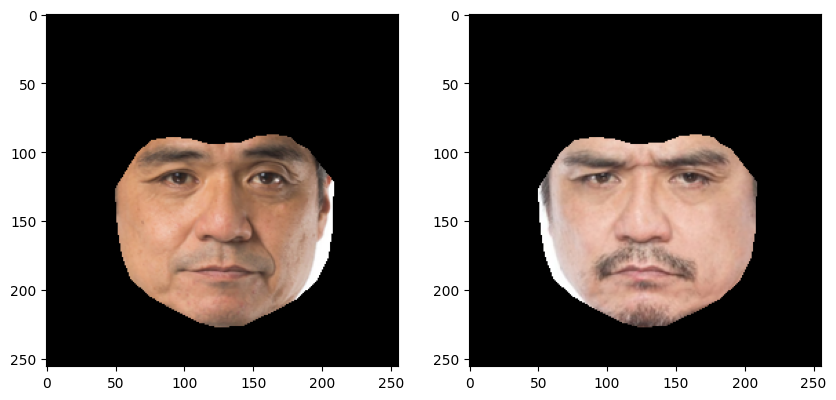

In [23]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 2, figsize=(5*2, 5))
ax[0].imshow(batch_from_faceall[0].permute([1, 2, 0]).cpu() / 2 + 0.5)
ax[1].imshow(batch_from_faceall[1].permute([1, 2, 0]).cpu() / 2 + 0.5)
plt.show()

In [24]:
cond_change_faceall = cls_model.normalize(cond_from_faceall[1][None]) - cls_model.normalize(cond_from_faceall[0][None])

xTs_faceall = torch.tensor([], device=device)
conds_faceall = torch.tensor([], device=device)
for i in range(num_to):
    xTs_tmp = torch.tensor([], device=device)
    conds_tmp = torch.tensor([], device=device)
    xT_change = xT_to[i] - intp_x_from[0]
    xT_to_s = torch.linalg.norm(xT_to[i])
    for j,alp in enumerate(alpha):
        xT2 = intp_x_from[j] + xT_change
        xT2_s = torch.linalg.norm(xT2)
        xT2 = xT2 / xT2_s * xT_to_s
        xTs_tmp = torch.cat([xTs_tmp, xT2[None]], dim=0)
        xT_change = xTs_tmp[j] - intp_x_from[j]
        xT_to_s = torch.linalg.norm(xTs_tmp[j])
        cond2 = cond_to_norm[i] + alp * cond_change_faceall
        cond2 = cls_model.denormalize(cond2)
        conds_tmp = torch.cat([conds_tmp, cond2], dim=0)
    xTs_faceall = torch.cat([xTs_faceall, xTs_tmp[None]], dim=0)
    conds_faceall = torch.cat([conds_faceall, conds_tmp[None]], dim=0)

In [25]:
preds_faceall = torch.tensor([], device=device)
for i in range(num_to):
    preds_tmp = torch.tensor([], device=device)
    for j in range(len(alpha)):
        pred = model.render(xTs_faceall[i,j][None], conds_faceall[i,j][None], T=20)
        preds_tmp = torch.cat([preds_tmp, pred], dim=0)
    preds_faceall = torch.cat([preds_faceall, preds_tmp[None]], dim=0)

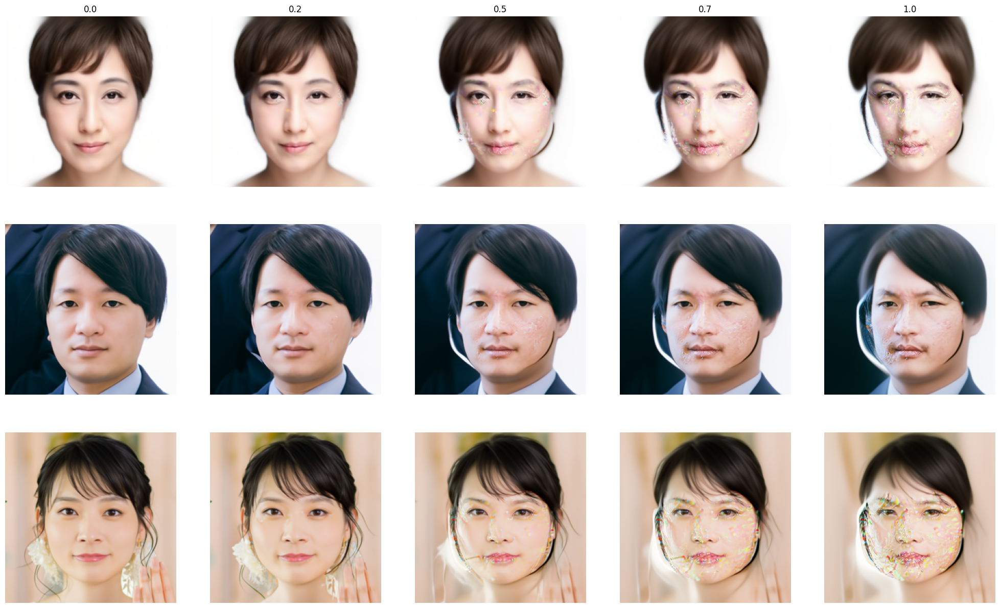

In [26]:
import matplotlib.pyplot as plt

num_show = 5
fig,ax = plt.subplots(num_to, num_show, figsize=(5*num_show, 5*num_to))
for i,pred in enumerate(preds_faceall):
    for j,k in enumerate(np.linspace(0,len(pred)-1,num_show,dtype=np.uint8)):
        if len(preds_faceall) < 2:
            ax[j].imshow(pred[k].permute(1,2,0).cpu())
            ax[j].set_title(np.array(alpha[k].cpu()))
            ax[j].axis('off')
        else:
            ax[i,j].imshow(pred[k].permute(1,2,0).cpu())
            if i == 0:
                ax[i,j].set_title(np.array(alpha[k].cpu()))
            ax[i,j].axis('off')

In [27]:
from PIL import Image

preds_faceall_pil = []
for pred in preds_faceall:
    pred_pil = []
    for p in pred:
        p_np = np.array((p*255).permute(1,2,0).cpu()).astype(np.uint8)
        pred_pil.append(Image.fromarray(p_np))
    preds_faceall_pil.append(pred_pil)

## eye

In [28]:
if is_avg:
    index_pts = [6,7]  # avg_face用
elif is_crop:
    index_pts = [2,3]  # crop用
else:
    index_pts = [0,5]
batch_from_eye = torch.stack([batch_from[index_pts[0]], batch_from[index_pts[1]]]).to(device)
cond_from_eye = model.encode(batch_from_eye)
xT_from_eye = model.encode_stochastic(batch_from_eye, cond_from_eye, T=250)

intp_from = cond_from_eye[0][None] * (1 - alpha[:, None]) + cond_from_eye[1][None] * alpha[:, None]
theta_from = torch.arccos(cos(xT_from_eye[0], xT_from_eye[1]))
x_shape = xT_from_eye[0].shape
intp_x_from = (torch.sin((1 - alpha[:, None]) * theta_from) * xT_from_eye[0].flatten(0, 2)[None] + torch.sin(alpha[:, None] * theta_from) * xT_from_eye[1].flatten(0, 2)[None]) / torch.sin(theta_from)
intp_x_from = intp_x_from.view(-1, *x_shape)

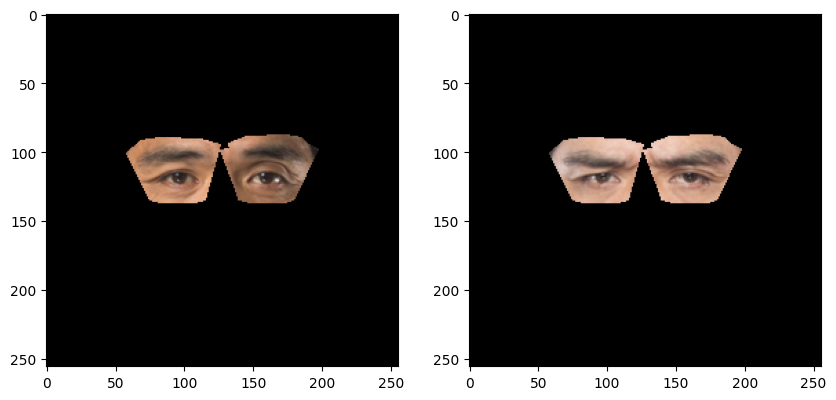

In [29]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 2, figsize=(5*2, 5))
ax[0].imshow(batch_from_eye[0].permute([1, 2, 0]).cpu() / 2 + 0.5)
ax[1].imshow(batch_from_eye[1].permute([1, 2, 0]).cpu() / 2 + 0.5)
plt.show()

In [30]:
cond_change_eye = cls_model.normalize(cond_from_eye[1][None]) - cls_model.normalize(cond_from_eye[0][None])

xTs_eye = torch.tensor([], device=device)
conds_eye = torch.tensor([], device=device)
for i in range(num_to):
    xTs_tmp = torch.tensor([], device=device)
    conds_tmp = torch.tensor([], device=device)
    xT_change = xT_to[i] - intp_x_from[0]
    xT_to_s = torch.linalg.norm(xT_to[i])
    for j,alp in enumerate(alpha):
        xT2 = intp_x_from[j] + xT_change
        xT2_s = torch.linalg.norm(xT2)
        xT2 = xT2 / xT2_s * xT_to_s
        xTs_tmp = torch.cat([xTs_tmp, xT2[None]], dim=0)
        xT_change = xTs_tmp[j] - intp_x_from[j]
        xT_to_s = torch.linalg.norm(xTs_tmp[j])
        cond2 = cond_to_norm[i] + alp * cond_change_eye
        cond2 = cls_model.denormalize(cond2)
        conds_tmp = torch.cat([conds_tmp, cond2], dim=0)
    xTs_eye = torch.cat([xTs_eye, xTs_tmp[None]], dim=0)
    conds_eye = torch.cat([conds_eye, conds_tmp[None]], dim=0)

In [31]:
preds_eye = torch.tensor([], device=device)
for i in range(num_to):
    preds_tmp = torch.tensor([], device=device)
    for j in range(len(alpha)):
        pred = model.render(xTs_eye[i,j][None], conds_eye[i,j][None], T=20)
        preds_tmp = torch.cat([preds_tmp, pred], dim=0)
    preds_eye = torch.cat([preds_eye, preds_tmp[None]], dim=0)

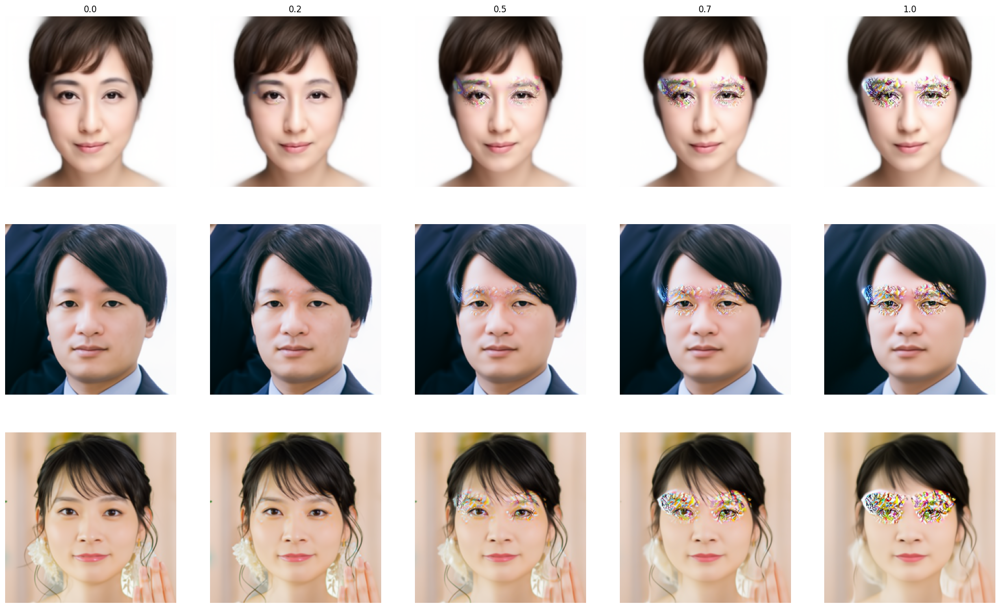

In [32]:
import matplotlib.pyplot as plt

num_show = 5
fig,ax = plt.subplots(num_to, num_show, figsize=(5*num_show, 5*num_to))
for i,pred in enumerate(preds_eye):
    for j,k in enumerate(np.linspace(0,len(pred)-1,num_show,dtype=np.uint8)):
        if len(preds_eye) < 2:
            ax[j].imshow(pred[k].permute(1,2,0).cpu())
            ax[j].set_title(np.array(alpha[k].cpu()))
            ax[j].axis('off')
        else:
            ax[i,j].imshow(pred[k].permute(1,2,0).cpu())
            if i == 0:
                ax[i,j].set_title(np.array(alpha[k].cpu()))
            ax[i,j].axis('off')

In [33]:
from PIL import Image

preds_eye_pil = []
for pred in preds_eye:
    pred_pil = []
    for p in pred:
        p_np = np.array((p*255).permute(1,2,0).cpu()).astype(np.uint8)
        pred_pil.append(Image.fromarray(p_np))
    preds_eye_pil.append(pred_pil)

## eye2

In [34]:
if is_avg:
    index_pts = [8,9]  # avg_face用
elif is_crop:
    index_pts = [4,5]  # crop用
else:
    index_pts = [0,6]
batch_from_eye2 = torch.stack([batch_from[index_pts[0]], batch_from[index_pts[1]]]).to(device)
cond_from_eye2 = model.encode(batch_from_eye2)
xT_from_eye2 = model.encode_stochastic(batch_from_eye2, cond_from_eye2, T=250)

intp_from = cond_from_eye2[0][None] * (1 - alpha[:, None]) + cond_from_eye2[1][None] * alpha[:, None]
theta_from = torch.arccos(cos(xT_from_eye2[0], xT_from_eye2[1]))
x_shape = xT_from_eye2[0].shape
intp_x_from = (torch.sin((1 - alpha[:, None]) * theta_from) * xT_from_eye2[0].flatten(0, 2)[None] + torch.sin(alpha[:, None] * theta_from) * xT_from_eye2[1].flatten(0, 2)[None]) / torch.sin(theta_from)
intp_x_from = intp_x_from.view(-1, *x_shape)

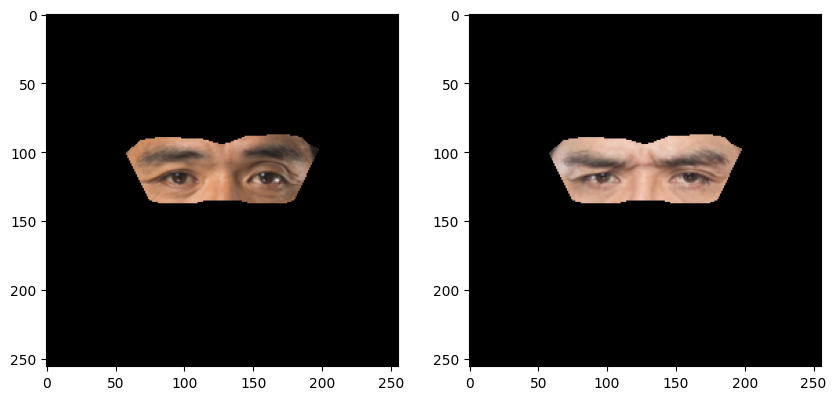

In [35]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 2, figsize=(5*2, 5))
ax[0].imshow(batch_from_eye2[0].permute([1, 2, 0]).cpu() / 2 + 0.5)
ax[1].imshow(batch_from_eye2[1].permute([1, 2, 0]).cpu() / 2 + 0.5)
plt.show()

In [36]:
cond_change_eye2 = cls_model.normalize(cond_from_eye2[1][None]) - cls_model.normalize(cond_from_eye2[0][None])

xTs_eye2 = torch.tensor([], device=device)
conds_eye2 = torch.tensor([], device=device)
for i in range(num_to):
    xTs_tmp = torch.tensor([], device=device)
    conds_tmp = torch.tensor([], device=device)
    xT_change = xT_to[i] - intp_x_from[0]
    xT_to_s = torch.linalg.norm(xT_to[i])
    for j,alp in enumerate(alpha):
        xT2 = intp_x_from[j] + xT_change
        xT2_s = torch.linalg.norm(xT2)
        xT2 = xT2 / xT2_s * xT_to_s
        xTs_tmp = torch.cat([xTs_tmp, xT2[None]], dim=0)
        xT_change = xTs_tmp[j] - intp_x_from[j]
        xT_to_s = torch.linalg.norm(xTs_tmp[j])
        cond2 = cond_to_norm[i] + alp * cond_change_eye2
        cond2 = cls_model.denormalize(cond2)
        conds_tmp = torch.cat([conds_tmp, cond2], dim=0)
    xTs_eye2 = torch.cat([xTs_eye2, xTs_tmp[None]], dim=0)
    conds_eye2 = torch.cat([conds_eye2, conds_tmp[None]], dim=0)

In [37]:
preds_eye2 = torch.tensor([], device=device)
for i in range(num_to):
    preds_tmp = torch.tensor([], device=device)
    for j in range(len(alpha)):
        pred = model.render(xTs_eye2[i,j][None], conds_eye2[i,j][None], T=20)
        preds_tmp = torch.cat([preds_tmp, pred], dim=0)
    preds_eye2 = torch.cat([preds_eye2, preds_tmp[None]], dim=0)

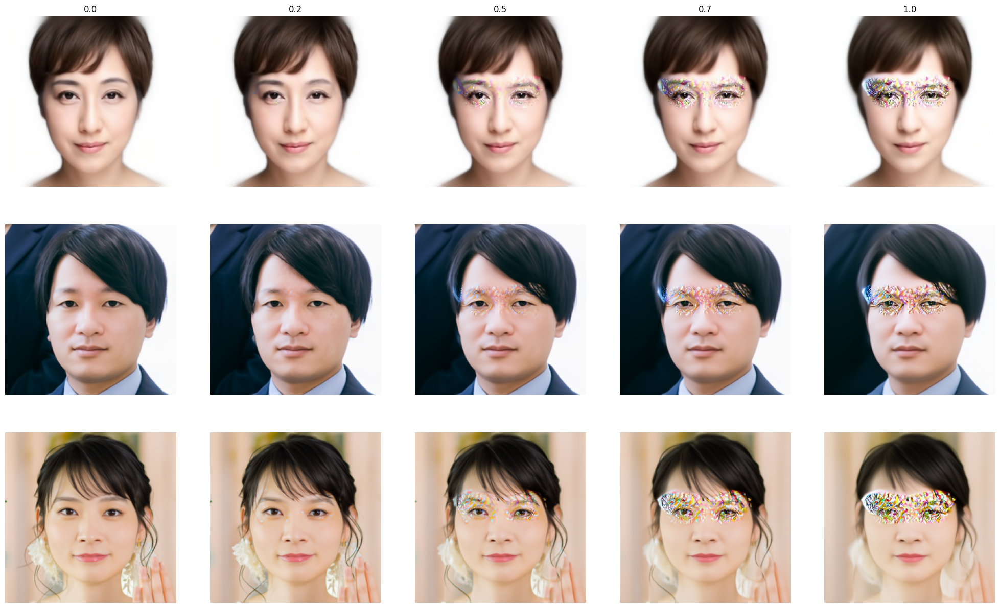

In [38]:
import matplotlib.pyplot as plt

num_show = 5
fig,ax = plt.subplots(num_to, num_show, figsize=(5*num_show, 5*num_to))
for i,pred in enumerate(preds_eye2):
    for j,k in enumerate(np.linspace(0,len(pred)-1,num_show,dtype=np.uint8)):
        if len(preds_eye2) < 2:
            ax[j].imshow(pred[k].permute(1,2,0).cpu())
            ax[j].set_title(np.array(alpha[k].cpu()))
            ax[j].axis('off')
        else:
            ax[i,j].imshow(pred[k].permute(1,2,0).cpu())
            if i == 0:
                ax[i,j].set_title(np.array(alpha[k].cpu()))
            ax[i,j].axis('off')

In [39]:
from PIL import Image

preds_eye2_pil = []
for pred in preds_eye2:
    pred_pil = []
    for p in pred:
        p_np = np.array((p*255).permute(1,2,0).cpu()).astype(np.uint8)
        pred_pil.append(Image.fromarray(p_np))
    preds_eye2_pil.append(pred_pil)

## mouth

In [40]:
if is_avg:
    index_pts = [10,11]  # avg_face用
elif is_crop:
    index_pts = [6,7]  # crop用
else:
    index_pts = [0,7]
batch_from_mouth = torch.stack([batch_from[index_pts[0]], batch_from[index_pts[1]]]).to(device)
cond_from_mouth = model.encode(batch_from_mouth)
xT_from_mouth = model.encode_stochastic(batch_from_mouth, cond_from_mouth, T=250)

intp_from = cond_from_mouth[0][None] * (1 - alpha[:, None]) + cond_from_mouth[1][None] * alpha[:, None]
theta_from = torch.arccos(cos(xT_from_mouth[0], xT_from_mouth[1]))
x_shape = xT_from_mouth[0].shape
intp_x_from = (torch.sin((1 - alpha[:, None]) * theta_from) * xT_from_mouth[0].flatten(0, 2)[None] + torch.sin(alpha[:, None] * theta_from) * xT_from_mouth[1].flatten(0, 2)[None]) / torch.sin(theta_from)
intp_x_from = intp_x_from.view(-1, *x_shape)

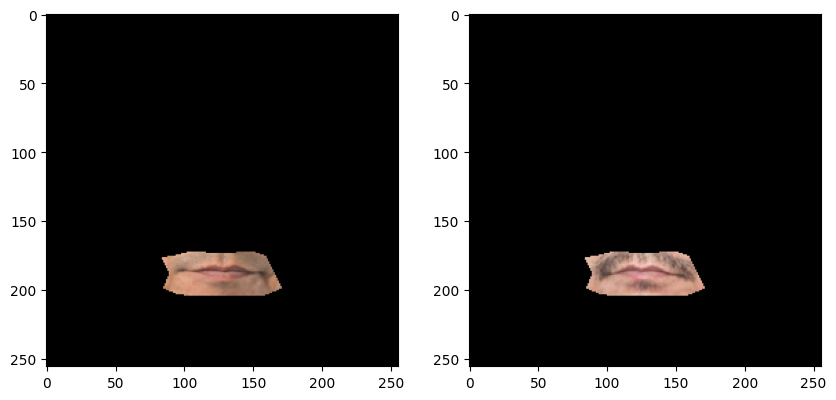

In [41]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 2, figsize=(5*2, 5))
ax[0].imshow(batch_from_mouth[0].permute([1, 2, 0]).cpu() / 2 + 0.5)
ax[1].imshow(batch_from_mouth[1].permute([1, 2, 0]).cpu() / 2 + 0.5)
plt.show()

In [42]:
cond_change_mouth = cls_model.normalize(cond_from_mouth[1][None]) - cls_model.normalize(cond_from_mouth[0][None])

xTs_mouth = torch.tensor([], device=device)
conds_mouth = torch.tensor([], device=device)
for i in range(num_to):
    xTs_tmp = torch.tensor([], device=device)
    conds_tmp = torch.tensor([], device=device)
    xT_change = xT_to[i] - intp_x_from[0]
    xT_to_s = torch.linalg.norm(xT_to[i])
    for j,alp in enumerate(alpha):
        xT2 = intp_x_from[j] + xT_change
        xT2_s = torch.linalg.norm(xT2)
        xT2 = xT2 / xT2_s * xT_to_s
        xTs_tmp = torch.cat([xTs_tmp, xT2[None]], dim=0)
        xT_change = xTs_tmp[j] - intp_x_from[j]
        xT_to_s = torch.linalg.norm(xTs_tmp[j])
        cond2 = cond_to_norm[i] + alp * cond_change_mouth
        cond2 = cls_model.denormalize(cond2)
        conds_tmp = torch.cat([conds_tmp, cond2], dim=0)
    xTs_mouth = torch.cat([xTs_mouth, xTs_tmp[None]], dim=0)
    conds_mouth = torch.cat([conds_mouth, conds_tmp[None]], dim=0)

In [43]:
preds_mouth = torch.tensor([], device=device)
for i in range(num_to):
    preds_tmp = torch.tensor([], device=device)
    for j in range(len(alpha)):
        pred = model.render(xTs_mouth[i,j][None], conds_mouth[i,j][None], T=20)
        preds_tmp = torch.cat([preds_tmp, pred], dim=0)
    preds_mouth = torch.cat([preds_mouth, preds_tmp[None]], dim=0)

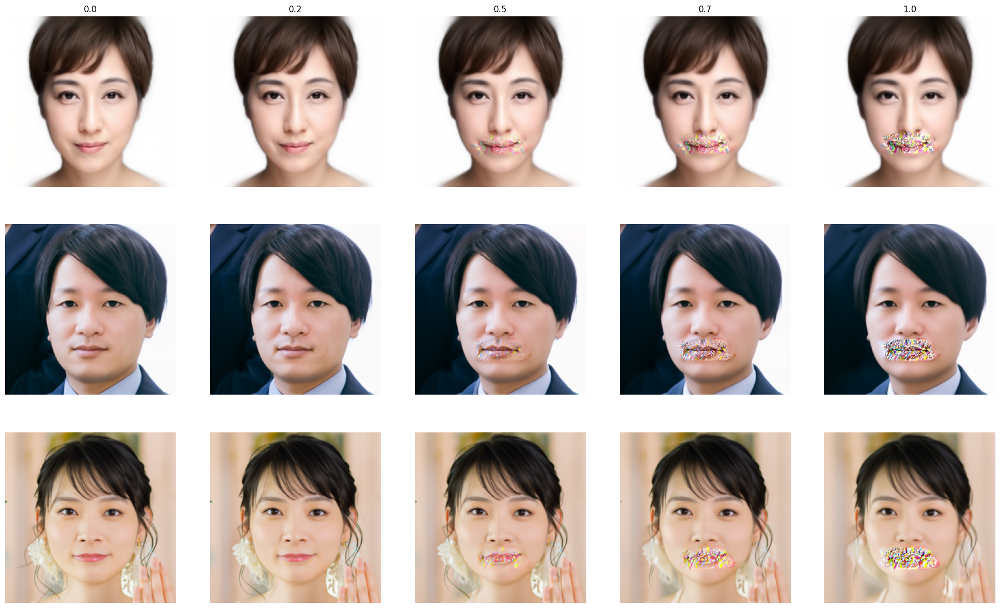

In [44]:
import matplotlib.pyplot as plt

num_show = 5
fig,ax = plt.subplots(num_to, num_show, figsize=(5*num_show, 5*num_to))
for i,pred in enumerate(preds_mouth):
    for j,k in enumerate(np.linspace(0,len(pred)-1,num_show,dtype=np.uint8)):
        if len(preds_mouth) < 2:
            ax[j].imshow(pred[k].permute(1,2,0).cpu())
            ax[j].set_title(np.array(alpha[k].cpu()))
            ax[j].axis('off')
        else:
            ax[i,j].imshow(pred[k].permute(1,2,0).cpu())
            if i == 0:
                ax[i,j].set_title(np.array(alpha[k].cpu()))
            ax[i,j].axis('off')

In [45]:
from PIL import Image

preds_mouth_pil = []
for pred in preds_mouth:
    pred_pil = []
    for p in pred:
        p_np = np.array((p*255).permute(1,2,0).cpu()).astype(np.uint8)
        pred_pil.append(Image.fromarray(p_np))
    preds_mouth_pil.append(pred_pil)

## eye&mouth

In [46]:
if is_avg:
    index_pts = [12,13]  # avg_face用
elif is_crop:
    index_pts = [8,9]  # crop用
else:
    index_pts = [0,8]
batch_from_eyemouth = torch.stack([batch_from[index_pts[0]], batch_from[index_pts[1]]]).to(device)
cond_from_eyemouth = model.encode(batch_from_eyemouth)
xT_from_eyemouth = model.encode_stochastic(batch_from_eyemouth, cond_from_eyemouth, T=250)

intp_from = cond_from_eyemouth[0][None] * (1 - alpha[:, None]) + cond_from_eyemouth[1][None] * alpha[:, None]
theta_from = torch.arccos(cos(xT_from_eyemouth[0], xT_from_eyemouth[1]))
x_shape = xT_from_eyemouth[0].shape
intp_x_from = (torch.sin((1 - alpha[:, None]) * theta_from) * xT_from_eyemouth[0].flatten(0, 2)[None] + torch.sin(alpha[:, None] * theta_from) * xT_from_eyemouth[1].flatten(0, 2)[None]) / torch.sin(theta_from)
intp_x_from = intp_x_from.view(-1, *x_shape)

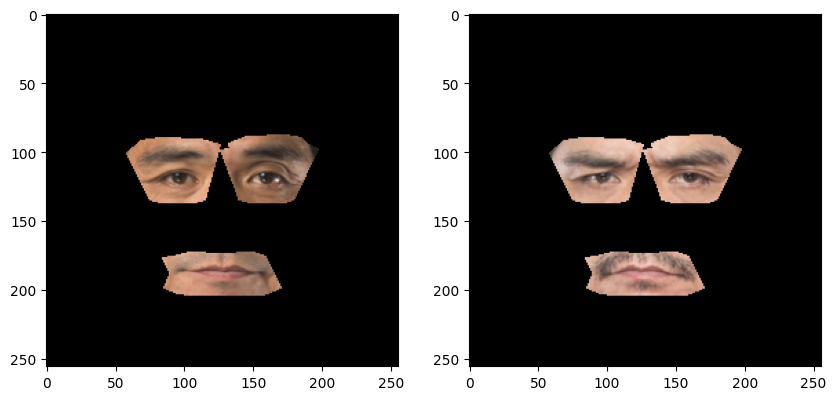

In [47]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 2, figsize=(5*2, 5))
ax[0].imshow(batch_from_eyemouth[0].permute([1, 2, 0]).cpu() / 2 + 0.5)
ax[1].imshow(batch_from_eyemouth[1].permute([1, 2, 0]).cpu() / 2 + 0.5)
plt.show()

In [48]:
cond_change_eyemouth = cls_model.normalize(cond_from_eyemouth[1][None]) - cls_model.normalize(cond_from_eyemouth[0][None])

xTs_eyemouth = torch.tensor([], device=device)
conds_eyemouth = torch.tensor([], device=device)
for i in range(num_to):
    xTs_tmp = torch.tensor([], device=device)
    conds_tmp = torch.tensor([], device=device)
    xT_change = xT_to[i] - intp_x_from[0]
    xT_to_s = torch.linalg.norm(xT_to[i])
    for j,alp in enumerate(alpha):
        xT2 = intp_x_from[j] + xT_change
        xT2_s = torch.linalg.norm(xT2)
        xT2 = xT2 / xT2_s * xT_to_s
        xTs_tmp = torch.cat([xTs_tmp, xT2[None]], dim=0)
        xT_change = xTs_tmp[j] - intp_x_from[j]
        xT_to_s = torch.linalg.norm(xTs_tmp[j])
        cond2 = cond_to_norm[i] + alp * cond_change_eyemouth
        cond2 = cls_model.denormalize(cond2)
        conds_tmp = torch.cat([conds_tmp, cond2], dim=0)
    xTs_eyemouth = torch.cat([xTs_eyemouth, xTs_tmp[None]], dim=0)
    conds_eyemouth = torch.cat([conds_eyemouth, conds_tmp[None]], dim=0)

In [49]:
preds_eyemouth = torch.tensor([], device=device)
for i in range(num_to):
    preds_tmp = torch.tensor([], device=device)
    for j in range(len(alpha)):
        pred = model.render(xTs_eyemouth[i,j][None], conds_eyemouth[i,j][None], T=20)
        preds_tmp = torch.cat([preds_tmp, pred], dim=0)
    preds_eyemouth = torch.cat([preds_eyemouth, preds_tmp[None]], dim=0)

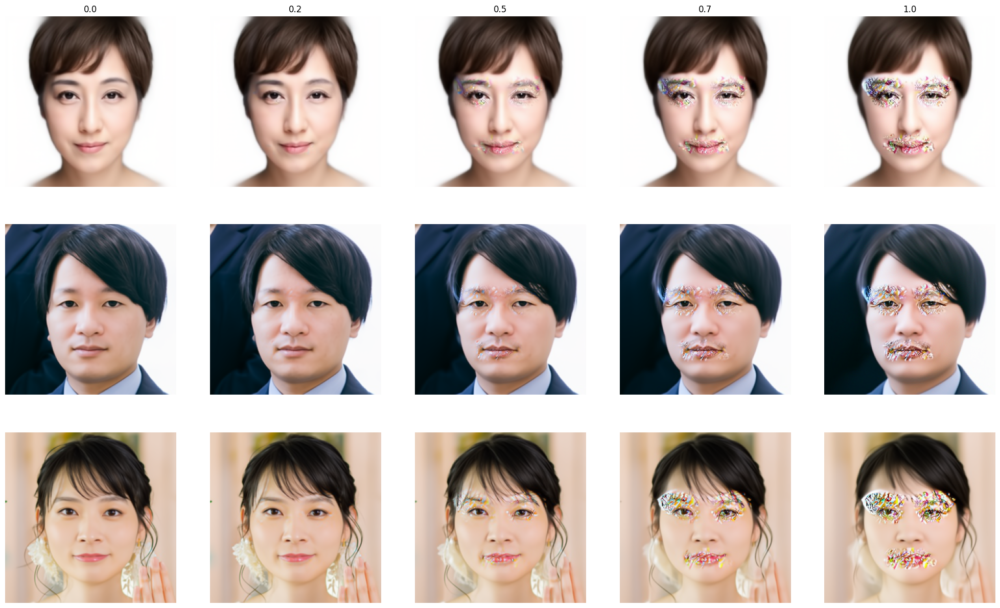

In [50]:
import matplotlib.pyplot as plt

num_show = 5
fig,ax = plt.subplots(num_to, num_show, figsize=(5*num_show, 5*num_to))
for i,pred in enumerate(preds_eyemouth):
    for j,k in enumerate(np.linspace(0,len(pred)-1,num_show,dtype=np.uint8)):
        if len(preds_eyemouth) < 2:
            ax[j].imshow(pred[k].permute(1,2,0).cpu())
            ax[j].set_title(np.array(alpha[k].cpu()))
            ax[j].axis('off')
        else:
            ax[i,j].imshow(pred[k].permute(1,2,0).cpu())
            if i == 0:
                ax[i,j].set_title(np.array(alpha[k].cpu()))
            ax[i,j].axis('off')

In [51]:
from PIL import Image

preds_eyemouth_pil = []
for pred in preds_eyemouth:
    pred_pil = []
    for p in pred:
        p_np = np.array((p*255).permute(1,2,0).cpu()).astype(np.uint8)
        pred_pil.append(Image.fromarray(p_np))
    preds_eyemouth_pil.append(pred_pil)

## mouth&nose

In [101]:
if is_avg:
    index_pts = [14,15]  # avg_face用
elif is_crop:
    index_pts = [10,11]  # crop用
else:
    index_pts = [0,9]
batch_from_mouthnose = torch.stack([batch_from[index_pts[0]], batch_from[index_pts[1]]]).to(device)
cond_from_mouthnose = model.encode(batch_from_mouthnose)
xT_from_mouthnose = model.encode_stochastic(batch_from_mouthnose, cond_from_mouthnose, T=250)

intp_from = cond_from_mouthnose[0][None] * (1 - alpha[:, None]) + cond_from_mouthnose[1][None] * alpha[:, None]
theta_from = torch.arccos(cos(xT_from_mouthnose[0], xT_from_mouthnose[1]))
x_shape = xT_from_mouthnose[0].shape
intp_x_from = (torch.sin((1 - alpha[:, None]) * theta_from) * xT_from_mouthnose[0].flatten(0, 2)[None] + torch.sin(alpha[:, None] * theta_from) * xT_from_mouthnose[1].flatten(0, 2)[None]) / torch.sin(theta_from)
intp_x_from = intp_x_from.view(-1, *x_shape)

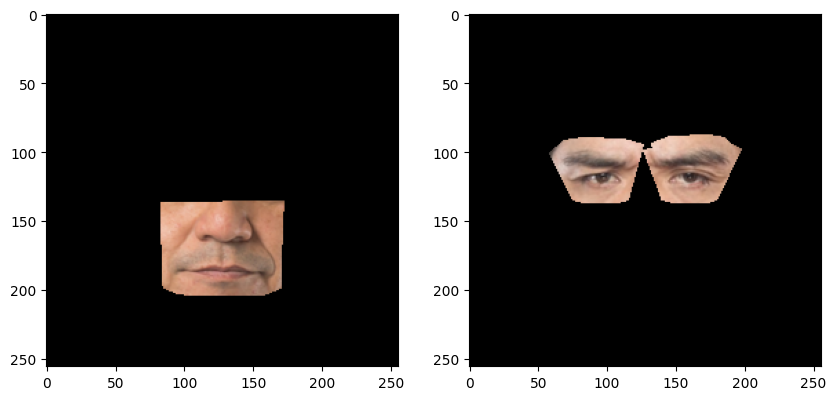

In [102]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 2, figsize=(5*2, 5))
ax[0].imshow(batch_from_mouthnose[0].permute([1, 2, 0]).cpu() / 2 + 0.5)
ax[1].imshow(batch_from_mouthnose[1].permute([1, 2, 0]).cpu() / 2 + 0.5)
plt.show()

In [54]:
cond_change_mouthnose = cls_model.normalize(cond_from_mouthnose[1][None]) - cls_model.normalize(cond_from_mouthnose[0][None])

xTs_mouthnose = torch.tensor([], device=device)
conds_mouthnose = torch.tensor([], device=device)
for i in range(num_to):
    xTs_tmp = torch.tensor([], device=device)
    conds_tmp = torch.tensor([], device=device)
    xT_change = xT_to[i] - intp_x_from[0]
    xT_to_s = torch.linalg.norm(xT_to[i])
    for j,alp in enumerate(alpha):
        xT2 = intp_x_from[j] + xT_change
        xT2_s = torch.linalg.norm(xT2)
        xT2 = xT2 / xT2_s * xT_to_s
        xTs_tmp = torch.cat([xTs_tmp, xT2[None]], dim=0)
        xT_change = xTs_tmp[j] - intp_x_from[j]
        xT_to_s = torch.linalg.norm(xTs_tmp[j])
        cond2 = cond_to_norm[i] + alp * cond_change_mouthnose
        cond2 = cls_model.denormalize(cond2)
        conds_tmp = torch.cat([conds_tmp, cond2], dim=0)
    xTs_mouthnose = torch.cat([xTs_mouthnose, xTs_tmp[None]], dim=0)
    conds_mouthnose = torch.cat([conds_mouthnose, conds_tmp[None]], dim=0)

In [55]:
preds_mouthnose = torch.tensor([], device=device)
for i in range(num_to):
    preds_tmp = torch.tensor([], device=device)
    for j in range(len(alpha)):
        pred = model.render(xTs_mouthnose[i,j][None], conds_mouthnose[i,j][None], T=20)
        preds_tmp = torch.cat([preds_tmp, pred], dim=0)
    preds_mouthnose = torch.cat([preds_mouthnose, preds_tmp[None]], dim=0)

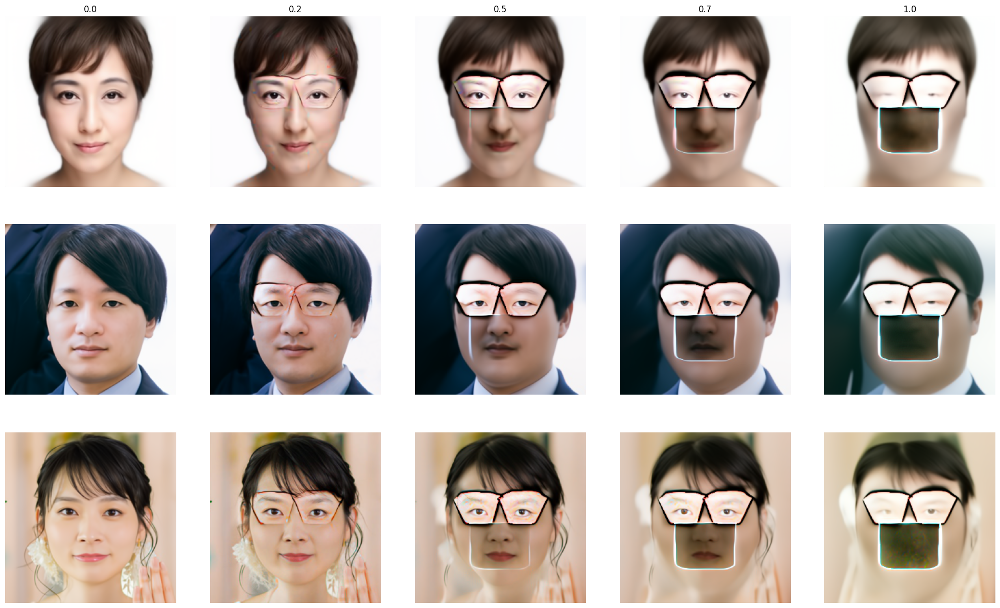

In [56]:
import matplotlib.pyplot as plt

num_show = 5
fig,ax = plt.subplots(num_to, num_show, figsize=(5*num_show, 5*num_to))
for i,pred in enumerate(preds_mouthnose):
    for j,k in enumerate(np.linspace(0,len(pred)-1,num_show,dtype=np.uint8)):
        if len(preds_mouthnose) < 2:
            ax[j].imshow(pred[k].permute(1,2,0).cpu())
            ax[j].set_title(np.array(alpha[k].cpu()))
            ax[j].axis('off')
        else:
            ax[i,j].imshow(pred[k].permute(1,2,0).cpu())
            if i == 0:
                ax[i,j].set_title(np.array(alpha[k].cpu()))
            ax[i,j].axis('off')

In [57]:
from PIL import Image

preds_mouthnose_pil = []
for pred in preds_mouthnose:
    pred_pil = []
    for p in pred:
        p_np = np.array((p*255).permute(1,2,0).cpu()).astype(np.uint8)
        pred_pil.append(Image.fromarray(p_np))
    preds_mouthnose_pil.append(pred_pil)

## gifの保存

In [91]:
if is_avg:
    dst_dir = f"imgs_test/imgs_parts_transfer_xT_avg/{name_from_dir}"
elif is_crop:
    dst_dir = f"imgs_test/imgs_parts_transfer_xT_crop/{name_from_dir}"
else:
    dst_dir = f"imgs_test/imgs_parts_transfer_xT/{name_from_dir}"

### all

In [92]:
# dst_dir = f"imgs_test/imgs_parts_transfer_xT/{name_from_dir}"
for i,pred_pil in enumerate(preds_all_pil):
    dst_dir_parts = f"{dst_dir}/{names_batch_to[i]}/all/"
    if not os.path.exists(dst_dir_parts): os.makedirs(dst_dir_parts)
    file_name = f"amp{np.array(alpha.detach().cpu())[0]:.2f}_{np.array(alpha.detach().cpu())[-1]:.2f}_{len(alpha)}.gif"
    dst_path = dst_dir_parts + file_name

    pred_pil[0].save(
        dst_path,
        format="gif",
        save_all=True,
        append_images=pred_pil,
        duration=3000//(len(alpha)),
        loop=0,
    )

### pose

In [93]:
# dst_dir = f"imgs_test/imgs_parts_transfer_xT/{name_from_dir}"
for i,pred_pil in enumerate(preds_pose_pil):
    dst_dir_parts = f"{dst_dir}/{names_batch_to[i]}/pose/"
    if not os.path.exists(dst_dir_parts): os.makedirs(dst_dir_parts)
    file_name = f"amp{np.array(alpha.detach().cpu())[0]:.2f}_{np.array(alpha.detach().cpu())[-1]:.2f}_{len(alpha)}.gif"
    dst_path = dst_dir_parts + file_name

    pred_pil[0].save(
        dst_path,
        format="gif",
        save_all=True,
        append_images=pred_pil,
        duration=3000//(len(alpha)),
        loop=0,
    )

### face-all

In [59]:
# dst_dir = f"imgs_test/imgs_parts_transfer_xT/{name_from_dir}"
for i,pred_pil in enumerate(preds_faceall_pil):
    dst_dir_parts = f"{dst_dir}/{names_batch_to[i]}/face-all/"
    if not os.path.exists(dst_dir_parts): os.makedirs(dst_dir_parts)
    file_name = f"amp{np.array(alpha.detach().cpu())[0]:.2f}_{np.array(alpha.detach().cpu())[-1]:.2f}_{len(alpha)}.gif"
    dst_path = dst_dir_parts + file_name

    pred_pil[0].save(
        dst_path,
        format="gif",
        save_all=True,
        append_images=pred_pil,
        duration=3000//(len(alpha)),
        loop=0,
    )

### eye

In [60]:
# dst_dir = f"imgs_test/imgs_parts_transfer_xT/{name_from_dir}"
for i,pred_pil in enumerate(preds_eye_pil):
    dst_dir_parts = f"{dst_dir}/{names_batch_to[i]}/eye/"
    if not os.path.exists(dst_dir_parts): os.makedirs(dst_dir_parts)
    file_name = f"amp{np.array(alpha.detach().cpu())[0]:.2f}_{np.array(alpha.detach().cpu())[-1]:.2f}_{len(alpha)}.gif"
    dst_path = dst_dir_parts + file_name

    pred_pil[0].save(
        dst_path,
        format="gif",
        save_all=True,
        append_images=pred_pil,
        duration=3000//(len(alpha)),
        loop=0,
    )

### eye2

In [61]:
# dst_dir = f"imgs_test/imgs_parts_transfer_xT/{name_from_dir}"
for i,pred_pil in enumerate(preds_eye2_pil):
    dst_dir_parts = f"{dst_dir}/{names_batch_to[i]}/eye2/"
    if not os.path.exists(dst_dir_parts): os.makedirs(dst_dir_parts)
    file_name = f"amp{np.array(alpha.detach().cpu())[0]:.2f}_{np.array(alpha.detach().cpu())[-1]:.2f}_{len(alpha)}.gif"
    dst_path = dst_dir_parts + file_name

    pred_pil[0].save(
        dst_path,
        format="gif",
        save_all=True,
        append_images=pred_pil,
        duration=3000//(len(alpha)),
        loop=0,
    )

### mouth

In [62]:
# dst_dir = f"imgs_test/imgs_parts_transfer_xT/{name_from_dir}"
for i,pred_pil in enumerate(preds_mouth_pil):
    dst_dir_parts = f"{dst_dir}/{names_batch_to[i]}/mouth/"
    if not os.path.exists(dst_dir_parts): os.makedirs(dst_dir_parts)
    file_name = f"amp{np.array(alpha.detach().cpu())[0]:.2f}_{np.array(alpha.detach().cpu())[-1]:.2f}_{len(alpha)}.gif"
    dst_path = dst_dir_parts + file_name

    pred_pil[0].save(
        dst_path,
        format="gif",
        save_all=True,
        append_images=pred_pil,
        duration=3000//(len(alpha)),
        loop=0,
    )

### eye&mouth

In [63]:
# dst_dir = f"imgs_test/imgs_parts_transfer_xT/{name_from_dir}"
for i,pred_pil in enumerate(preds_eyemouth_pil):
    dst_dir_parts = f"{dst_dir}/{names_batch_to[i]}/eye-mouth/"
    if not os.path.exists(dst_dir_parts): os.makedirs(dst_dir_parts)
    file_name = f"amp{np.array(alpha.detach().cpu())[0]:.2f}_{np.array(alpha.detach().cpu())[-1]:.2f}_{len(alpha)}.gif"
    dst_path = dst_dir_parts + file_name

    pred_pil[0].save(
        dst_path,
        format="gif",
        save_all=True,
        append_images=pred_pil,
        duration=3000//(len(alpha)),
        loop=0,
    )

### mouth&nose

In [64]:
# dst_dir = f"imgs_test/imgs_parts_transfer_xT/{name_from_dir}"
for i,pred_pil in enumerate(preds_mouthnose_pil):
    dst_dir_parts = f"{dst_dir}/{names_batch_to[i]}/mouth-nose/"
    if not os.path.exists(dst_dir_parts): os.makedirs(dst_dir_parts)
    file_name = f"amp{np.array(alpha.detach().cpu())[0]:.2f}_{np.array(alpha.detach().cpu())[-1]:.2f}_{len(alpha)}.gif"
    dst_path = dst_dir_parts + file_name

    pred_pil[0].save(
        dst_path,
        format="gif",
        save_all=True,
        append_images=pred_pil,
        duration=3000//(len(alpha)),
        loop=0,
    )

## 静止画像（フレーム）の保存

### all

In [94]:
from torchvision.utils import save_image

# dst_dir = f"imgs_test/imgs_parts_transfer_xT/{name_from_dir}"
# select_ind = {0,12,24,36,47,59}
select_ind = {0,2,4,6,8,10}
for i,pred in enumerate(preds_all):
    dst_dir_parts = f"{dst_dir}/{names_batch_to[i]}/all/"
    if not os.path.exists(dst_dir_parts): os.makedirs(dst_dir_parts)
    for j,p in enumerate(pred):
        if j in select_ind:
            file_name = f"{dst_dir_parts}amp{np.array(alpha.detach().cpu())[j]:.2f}.png"
            save_image(p, file_name, format='PNG')

### pose

In [95]:
from torchvision.utils import save_image

# dst_dir = f"imgs_test/imgs_parts_transfer_xT/{name_from_dir}"
# select_ind = {0,12,24,36,47,59}
select_ind = {0,2,4,6,8,10}
for i,pred in enumerate(preds_pose):
    dst_dir_parts = f"{dst_dir}/{names_batch_to[i]}/pose/"
    if not os.path.exists(dst_dir_parts): os.makedirs(dst_dir_parts)
    for j,p in enumerate(pred):
        if j in select_ind:
            file_name = f"{dst_dir_parts}amp{np.array(alpha.detach().cpu())[j]:.2f}.png"
            save_image(p, file_name, format='PNG')

### face-all

In [65]:
from torchvision.utils import save_image

# dst_dir = f"imgs_test/imgs_parts_transfer_xT/{name_from_dir}"
# select_ind = {0,12,24,36,47,59}
select_ind = {0,2,4,6,8,10}
for i,pred in enumerate(preds_faceall):
    dst_dir_parts = f"{dst_dir}/{names_batch_to[i]}/face-all/"
    if not os.path.exists(dst_dir_parts): os.makedirs(dst_dir_parts)
    for j,p in enumerate(pred):
        if j in select_ind:
            file_name = f"{dst_dir_parts}amp{np.array(alpha.detach().cpu())[j]:.2f}.png"
            save_image(p, file_name, format='PNG')

### eye

In [66]:
from torchvision.utils import save_image

# dst_dir = f"imgs_test/imgs_parts_transfer_xT/{name_from_dir}"
# select_ind = {0,12,24,36,47,59}
select_ind = {0,2,4,6,8,10}
for i,pred in enumerate(preds_eye):
    dst_dir_parts = f"{dst_dir}/{names_batch_to[i]}/eye/"
    if not os.path.exists(dst_dir_parts): os.makedirs(dst_dir_parts)
    for j,p in enumerate(pred):
        if j in select_ind:
            file_name = f"{dst_dir_parts}amp{np.array(alpha.detach().cpu())[j]:.2f}.png"
            save_image(p, file_name, format='PNG')

### eye2

In [67]:
from torchvision.utils import save_image

# dst_dir = f"imgs_test/imgs_parts_transfer_xT/{name_from_dir}"
# select_ind = {0,12,24,36,47,59}
select_ind = {0,2,4,6,8,10}
for i,pred in enumerate(preds_eye2):
    dst_dir_parts = f"{dst_dir}/{names_batch_to[i]}/eye2/"
    if not os.path.exists(dst_dir_parts): os.makedirs(dst_dir_parts)
    for j,p in enumerate(pred):
        if j in select_ind:
            file_name = f"{dst_dir_parts}amp{np.array(alpha.detach().cpu())[j]:.2f}.png"
            save_image(p, file_name, format='PNG')

### mouth

In [68]:
from torchvision.utils import save_image

# dst_dir = f"imgs_test/imgs_parts_transfer_xT/{name_from_dir}"
# select_ind = {0,12,24,36,47,59}
select_ind = {0,2,4,6,8,10}
for i,pred in enumerate(preds_mouth):
    dst_dir_parts = f"{dst_dir}/{names_batch_to[i]}/mouth/"
    if not os.path.exists(dst_dir_parts): os.makedirs(dst_dir_parts)
    for j,p in enumerate(pred):
        if j in select_ind:
            file_name = f"{dst_dir_parts}amp{np.array(alpha.detach().cpu())[j]:.2f}.png"
            save_image(p, file_name, format='PNG')

### eye&mouth

In [69]:
from torchvision.utils import save_image

# dst_dir = f"imgs_test/imgs_parts_transfer_xT/{name_from_dir}"
# select_ind = {0,12,24,36,47,59}
select_ind = {0,2,4,6,8,10}
for i,pred in enumerate(preds_eyemouth):
    dst_dir_parts = f"{dst_dir}/{names_batch_to[i]}/eye-mouth/"
    if not os.path.exists(dst_dir_parts): os.makedirs(dst_dir_parts)
    for j,p in enumerate(pred):
        if j in select_ind:
            file_name = f"{dst_dir_parts}amp{np.array(alpha.detach().cpu())[j]:.2f}.png"
            save_image(p, file_name, format='PNG')

### mouth&nose

In [70]:
from torchvision.utils import save_image

# dst_dir = f"imgs_test/imgs_parts_transfer_xT/{name_from_dir}"
# select_ind = {0,12,24,36,47,59}
select_ind = {0,2,4,6,8,10}
for i,pred in enumerate(preds_mouthnose):
    dst_dir_parts = f"{dst_dir}/{names_batch_to[i]}/mouth-nose/"
    if not os.path.exists(dst_dir_parts): os.makedirs(dst_dir_parts)
    for j,p in enumerate(pred):
        if j in select_ind:
            file_name = f"{dst_dir_parts}amp{np.array(alpha.detach().cpu())[j]:.2f}.png"
            save_image(p, file_name, format='PNG')